In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import psycopg2
from sklearn.preprocessing import LabelEncoder
from category_encoders.ordinal import OrdinalEncoder
from sklearn.utils import resample
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB

import xgboost as xgb
from sklearn.model_selection import GridSearchCV


from sklearn.model_selection import KFold
import time


from sklearn.metrics import mean_squared_error, r2_score

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from tabulate import tabulate


import warnings
warnings.filterwarnings('ignore')

In [2]:
params = {
    "host": "localhost",
    "user": "postgres",
    "port": 5432,
    "password": "berke" 
}
connection = psycopg2.connect(**params, dbname= "postgres")

In [3]:
df = pd.read_sql("select * from public.fraud", connection)

In [4]:
df

,month,weekofmonth,dayofweek,make,accidentarea,dayofweekclaimed,monthclaimed,weekofmonthclaimed,sex,maritalstatus,...,ageofvehicle,ageofpolicyholder,policereportfiled,witnesspresent,agenttype,numberofsuppliments,addresschange_claim,numberofcars,year,basepolicy
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,...,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,...,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,...,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,...,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,...,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15415,Nov,4,Friday,Toyota,Urban,Tuesday,Nov,5,Male,Married,...,6 years,31 to 35,No,No,External,none,no change,1 vehicle,1996,Collision
15416,Nov,5,Thursday,Pontiac,Urban,Friday,Dec,1,Male,Married,...,6 years,31 to 35,No,No,External,more than 5,no change,3 to 4,1996,Liability
15417,Nov,5,Thursday,Toyota,Rural,Friday,Dec,1,Male,Single,...,5 years,26 to 30,No,No,External,1 to 2,no change,1 vehicle,1996,Collision
15418,Dec,1,Monday,Toyota,Urban,Thursday,Dec,2,Female,Married,...,2 years,31 to 35,No,No,External,more than 5,no change,1 vehicle,1996,All Perils


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15420 entries, 0 to 15419
Data columns (total 33 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   month                 15420 non-null  object
 1   weekofmonth           15420 non-null  int64 
 2   dayofweek             15420 non-null  object
 3   make                  15420 non-null  object
 4   accidentarea          15420 non-null  object
 5   dayofweekclaimed      15420 non-null  object
 6   monthclaimed          15420 non-null  object
 7   weekofmonthclaimed    15420 non-null  int64 
 8   sex                   15420 non-null  object
 9   maritalstatus         15420 non-null  object
 10  age                   15420 non-null  int64 
 11  fault                 15420 non-null  object
 12  policytype            15420 non-null  object
 13  vehiclecategory       15420 non-null  object
 14  vehicleprice          15420 non-null  object
 15  fraudfound_p          15420 non-null

In [6]:
df.columns

Index(['month', 'weekofmonth', 'dayofweek', 'make', 'accidentarea',
       'dayofweekclaimed', 'monthclaimed', 'weekofmonthclaimed', 'sex',
       'maritalstatus', 'age', 'fault', 'policytype', 'vehiclecategory',
       'vehicleprice', 'fraudfound_p', 'policynumber', 'repnumber',
       'deductible', 'driverrating', 'days_policy_accident',
       'days_policy_claim', 'pastnumberofclaims', 'ageofvehicle',
       'ageofpolicyholder', 'policereportfiled', 'witnesspresent', 'agenttype',
       'numberofsuppliments', 'addresschange_claim', 'numberofcars', 'year',
       'basepolicy'],
      dtype='object')

In [7]:
df.describe()

,weekofmonth,weekofmonthclaimed,age,fraudfound_p,policynumber,repnumber,deductible,driverrating,year
count,15420.000000,15420.000000,15420.000000,15420.000000,15420.000000,15420.000000,15420.000000,15420.000000,15420.000000
mean,2.788586,2.693969,39.855707,0.059857,7710.500000,8.483268,407.704280,2.487808,1994.866472
std,1.287585,1.259115,13.492377,0.237230,4451.514911,4.599948,43.950998,1.119453,0.803313
min,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,300.000000,1.000000,1994.000000
25%,2.000000,2.000000,31.000000,0.000000,3855.750000,5.000000,400.000000,1.000000,1994.000000
50%,3.000000,3.000000,38.000000,0.000000,7710.500000,8.000000,400.000000,2.000000,1995.000000
75%,4.000000,4.000000,48.000000,0.000000,11565.250000,12.000000,400.000000,3.000000,1996.000000
max,5.000000,5.000000,80.000000,1.000000,15420.000000,16.000000,700.000000,4.000000,1996.000000


In [8]:
df.head()

,month,weekofmonth,dayofweek,make,accidentarea,dayofweekclaimed,monthclaimed,weekofmonthclaimed,sex,maritalstatus,...,ageofvehicle,ageofpolicyholder,policereportfiled,witnesspresent,agenttype,numberofsuppliments,addresschange_claim,numberofcars,year,basepolicy
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,...,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,...,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,...,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,...,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,...,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision


In [9]:
df.isnull().sum()

month                   0
weekofmonth             0
dayofweek               0
make                    0
accidentarea            0
dayofweekclaimed        0
monthclaimed            0
weekofmonthclaimed      0
sex                     0
maritalstatus           0
age                     0
fault                   0
policytype              0
vehiclecategory         0
vehicleprice            0
fraudfound_p            0
policynumber            0
repnumber               0
deductible              0
driverrating            0
days_policy_accident    0
days_policy_claim       0
pastnumberofclaims      0
ageofvehicle            0
ageofpolicyholder       0
policereportfiled       0
witnesspresent          0
agenttype               0
numberofsuppliments     0
addresschange_claim     0
numberofcars            0
year                    0
basepolicy              0
dtype: int64

In [10]:
df.duplicated().sum()

0

In [11]:
df = df.rename(columns={'fraudfound_p': 'fraudfound'})

In [12]:
df

,month,weekofmonth,dayofweek,make,accidentarea,dayofweekclaimed,monthclaimed,weekofmonthclaimed,sex,maritalstatus,...,ageofvehicle,ageofpolicyholder,policereportfiled,witnesspresent,agenttype,numberofsuppliments,addresschange_claim,numberofcars,year,basepolicy
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,...,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,...,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,...,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,...,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,...,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15415,Nov,4,Friday,Toyota,Urban,Tuesday,Nov,5,Male,Married,...,6 years,31 to 35,No,No,External,none,no change,1 vehicle,1996,Collision
15416,Nov,5,Thursday,Pontiac,Urban,Friday,Dec,1,Male,Married,...,6 years,31 to 35,No,No,External,more than 5,no change,3 to 4,1996,Liability
15417,Nov,5,Thursday,Toyota,Rural,Friday,Dec,1,Male,Single,...,5 years,26 to 30,No,No,External,1 to 2,no change,1 vehicle,1996,Collision
15418,Dec,1,Monday,Toyota,Urban,Thursday,Dec,2,Female,Married,...,2 years,31 to 35,No,No,External,more than 5,no change,1 vehicle,1996,All Perils


In [13]:
df["fraudfound"].value_counts()

fraudfound
0    14497
1      923
Name: count, dtype: int64

In [14]:
def get_unique_values_df(df):
    """
    Generate a DataFrame displaying unique values for each column in the input DataFrame.

    Parameters:
    df (DataFrame): Input DataFrame containing data.

    Returns:
    DataFrame: DataFrame with columns 'Column Name' and 'Unique Values'.
    """
    pd.set_option('max_colwidth', None)
    data = []
    for column in df:
        unique_values = ', '.join(map(str, df[column].unique()))
        data.append([column, unique_values])

    # Create a new DataFrame to display the unique values
    unique_values_df = pd.DataFrame(data, columns=['Column Name', 'Unique Values'])
    return unique_values_df







get_unique_values_df(df)

,Column Name,Unique Values
0,month,"Dec, Jan, Oct, Jun, Feb, Nov, Apr, Mar, Aug, Jul, May, Sep"
1,weekofmonth,"5, 3, 2, 4, 1"
2,dayofweek,"Wednesday, Friday, Saturday, Monday, Tuesday, Sunday, Thursday"
3,make,"Honda, Toyota, Ford, Mazda, Chevrolet, Pontiac, Accura, Dodge, Mercury, Jaguar, Nisson, VW, Saab, Saturn, Porche, BMW, Mecedes, Ferrari, Lexus"
4,accidentarea,"Urban, Rural"
5,dayofweekclaimed,"Tuesday, Monday, Thursday, Friday, Wednesday, Saturday, Sunday, 0"
6,monthclaimed,"Jan, Nov, Jul, Feb, Mar, Dec, Apr, Aug, May, Jun, Sep, Oct, 0"
7,weekofmonthclaimed,"1, 4, 2, 3, 5"
8,sex,"Female, Male"
9,maritalstatus,"Single, Married, Widow, Divorced"


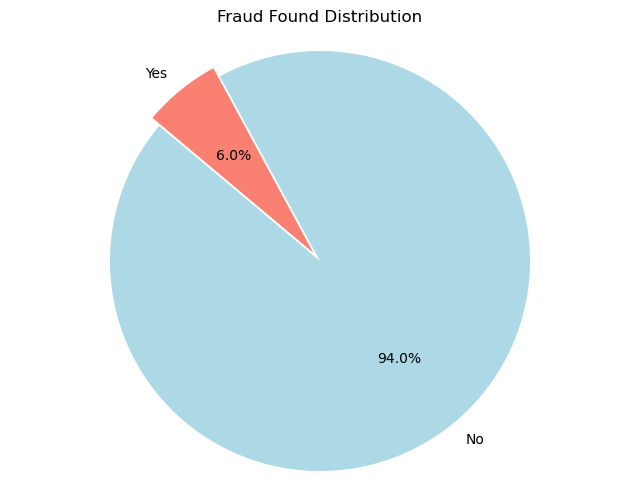

In [15]:
# Renkler
color_fraud = 'salmon'  # Dolandırıcılık yapanlar için kırmızı tonu
color_non_fraud = 'lightblue'  # Dolandırıcılık yapmayanlar için mavi tonu

# Veriyi hazırla
labels = df.fraudfound.value_counts().index
labels = ["No" if i==0 else "Yes" for i in labels]
sizes = df.fraudfound.value_counts().values

# Pastayı çiz
plt.figure(figsize=(8, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, explode=[0.05, 0], colors=[color_non_fraud, color_fraud])
plt.title('Fraud Found Distribution')
plt.axis('equal') 
plt.show()



In [16]:
##Burada görmüş olacağınız üzere dolandırıcılık yapanlar %6

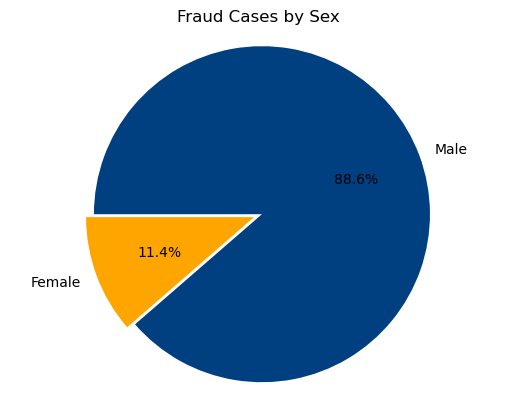

In [17]:
fraud_by_sex = df[df['fraudfound'] == 1].groupby('sex').size()

# Renk paleti
main_color = '#004080'  # Ana Renk: Koyu Mavi
accent_color = '#FFA500'  # Birincil Vurgu: Turuncu
secondary_color = '#808080'  # İkincil Vurgu: Gri
optional_color = '#6FA8DC'  # Opsiyonel: Açık Mavi

colors = [accent_color, main_color]  # Belirtilen renkleri kullanma

# Grafik çizimi
fig, ax = plt.subplots()
ax.pie(fraud_by_sex, labels=fraud_by_sex.index, autopct='%1.1f%%', startangle=180, explode=[0.05, 0], colors=colors)
ax.axis('equal')  # Daire şeklinde tutar
ax.set_title('Fraud Cases by Sex')

plt.show()


In [18]:
##Burada görmüş olacağınız üzere dolandırıcılık yapanların cinsiyet dağılımları

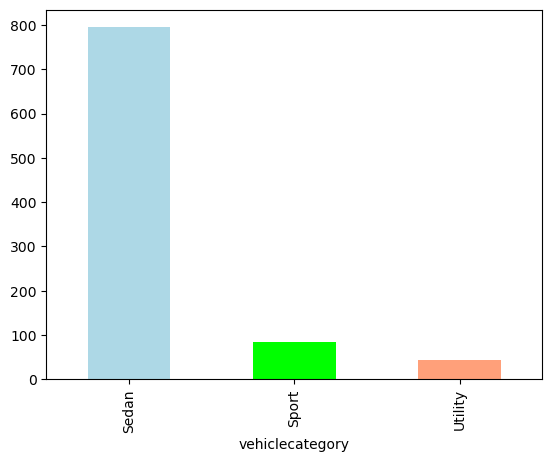

In [19]:
# Renkler
sedan_color = '#ADD8E6'  # Sedan için açık gri tonu
sport_color = '#00FF00'  # Sport için canlı yeşil
utility_color = '#FFA07A'  # Utility için yumuşak turuncu

# Filter the data for all claims that are Fraud
df_fraud = df[df['fraudfound'] == 1]  
# Count the number of claims in each vehicle category
fraud_counts = df_fraud['vehiclecategory'].value_counts()

# Grafik oluştur
fraud_counts.plot(kind='bar', color=[sedan_color, sport_color, utility_color])
plt.show()

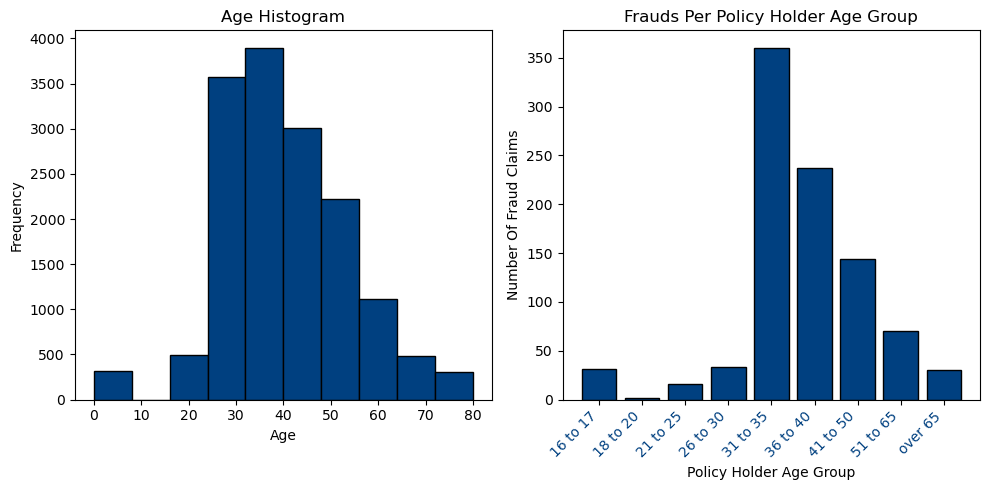

In [20]:
# Ana Renk: Koyu Mavi
main_color = '#004080'

plt.figure(figsize=(10, 5))

# Age histogram
plt.subplot(1, 2, 1)
plt.hist(df['age'], bins=10, edgecolor='black', color=main_color)
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.title('Age Histogram')

# Frauds Per Policy Holder Age Group histogram
plt.subplot(1, 2, 2)
policyAge = df.groupby('ageofpolicyholder')['fraudfound'].sum()
bars = plt.bar(policyAge.index, policyAge.values, edgecolor='black', color=main_color)
plt.title("Frauds Per Policy Holder Age Group")
plt.xlabel("Policy Holder Age Group")
plt.ylabel("Number Of Fraud Claims")
plt.xticks(rotation=45, ha='right', color=main_color)

plt.tight_layout()
plt.show()


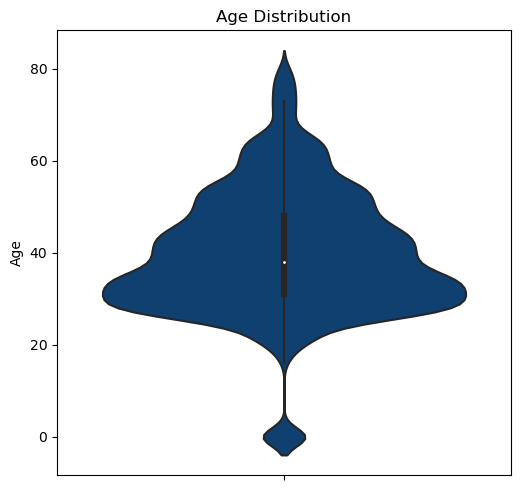

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ana Renk: Koyu Mavi
main_color = '#004080'

plt.figure(figsize=(10, 5))

# Violin Plot (Keman Grafiği)
plt.subplot(1, 2, 2)
sns.violinplot(data=df, y='age', color=main_color)
plt.title("Age Distribution")
plt.ylabel("Age")

plt.tight_layout()
plt.show()


In [22]:
##Burada görmüş olduğımuz gibi yaş dağılımını açıklıyoruz

In [23]:
#Burada Poliçe Sahibi Yaş Grubu Başına Dolandırıcılık grafiğini inceliyoruz

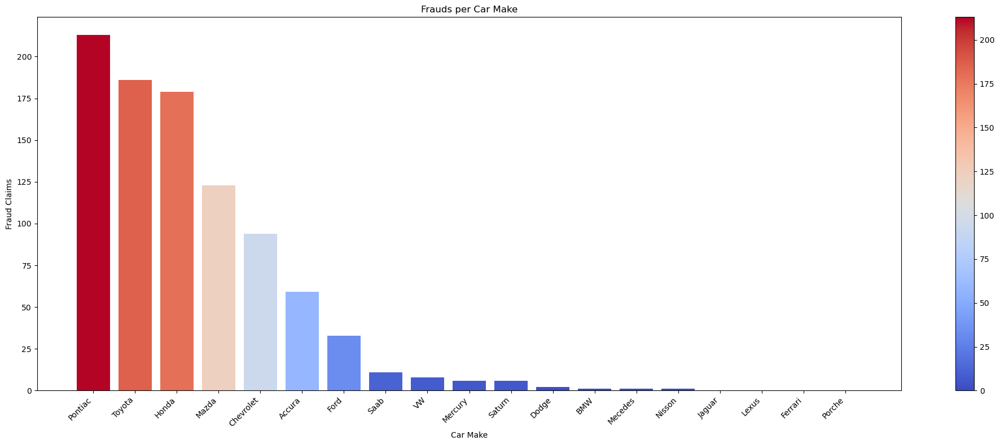

In [24]:
#Frauds per Car Make 
make_frauds = df.groupby('make')['fraudfound'].sum()
make_frauds = make_frauds.sort_values(ascending=False)

norm = plt.Normalize(make_frauds.min(), make_frauds.max())
colors = plt.cm.coolwarm(norm(make_frauds.values))

plt.figure(figsize=(20, 8))
bars = plt.bar(make_frauds.index, make_frauds.values, color=colors)
plt.title("Frauds per Car Make")
plt.xlabel("Car Make")
plt.ylabel("Fraud Claims")


sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [25]:
#Burada dolandırıcılık yapılan arac markalarını görüyoruz

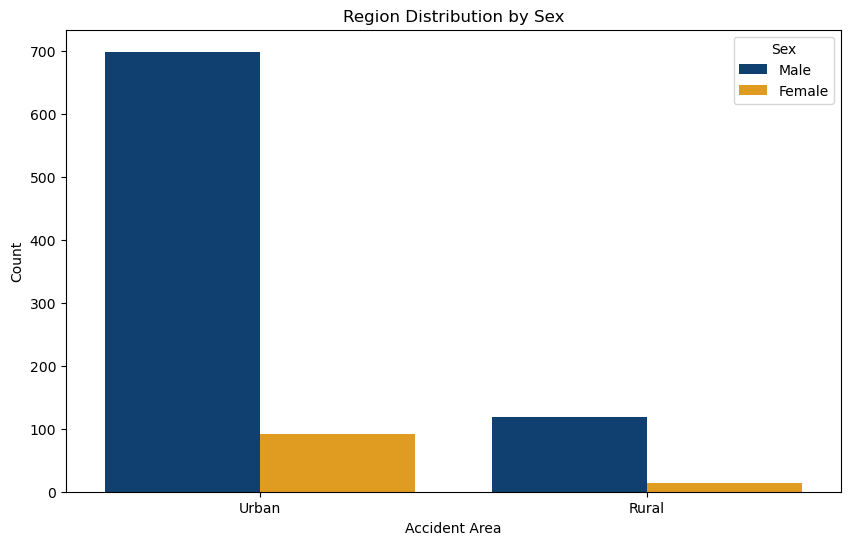

In [26]:
main_color = '#004080'  # Ana Renk: Koyu Mavi
accent_color = '#FFA500'  # Birincil Vurgu: Turuncu
secondary_color = '#808080'  # İkincil Vurgu: Gri
optional_color = '#6FA8DC'  # Opsiyonel: Açık Mavi

palette = [main_color, accent_color]

# Grafik çizimi
plt.figure(figsize=(10, 6))
sns.countplot(data=df[df['fraudfound'] == 1], x='accidentarea', hue='sex', palette=palette)
plt.title('Region Distribution by Sex')
plt.xlabel('Accident Area')
plt.ylabel('Count')
plt.legend(title='Sex')

plt.show()


In [27]:
# get rid of policy number column
df.drop(columns=['policynumber'], inplace=True)

In [28]:
def get_unique_values_df(df):
    """
    Generate a DataFrame displaying unique values for each column in the input DataFrame.

    Parameters:
    df (DataFrame): Input DataFrame containing data.

    Returns:
    DataFrame: DataFrame with columns 'Column Name' and 'Unique Values'.
    """
    pd.set_option('max_colwidth', None)
    data = []
    for column in df:
        unique_values = ', '.join(map(str, df[column].unique()))
        data.append([column, unique_values])

    # Create a new DataFrame to display the unique values
    unique_values_df = pd.DataFrame(data, columns=['Column Name', 'Unique Values'])
    return unique_values_df







get_unique_values_df(df)

,Column Name,Unique Values
0,month,"Dec, Jan, Oct, Jun, Feb, Nov, Apr, Mar, Aug, Jul, May, Sep"
1,weekofmonth,"5, 3, 2, 4, 1"
2,dayofweek,"Wednesday, Friday, Saturday, Monday, Tuesday, Sunday, Thursday"
3,make,"Honda, Toyota, Ford, Mazda, Chevrolet, Pontiac, Accura, Dodge, Mercury, Jaguar, Nisson, VW, Saab, Saturn, Porche, BMW, Mecedes, Ferrari, Lexus"
4,accidentarea,"Urban, Rural"
5,dayofweekclaimed,"Tuesday, Monday, Thursday, Friday, Wednesday, Saturday, Sunday, 0"
6,monthclaimed,"Jan, Nov, Jul, Feb, Mar, Dec, Apr, Aug, May, Jun, Sep, Oct, 0"
7,weekofmonthclaimed,"1, 4, 2, 3, 5"
8,sex,"Female, Male"
9,maritalstatus,"Single, Married, Widow, Divorced"


In [29]:
# Age sütunundaki 0 değerlerini bul
age_zero_indices = df[df['age'] == 0].index

# Rastgele 16 veya 17 değerleri oluştur
random_ages = np.random.choice([16, 17], size=len(age_zero_indices))

# 0 değerlerini rastgele 16 veya 17 ile değiştir
df.loc[age_zero_indices, 'age'] = random_ages


In [30]:
# Age sütunundaki 0 ve -1 değerlerini bul
invalid_age_indices = df[df['age'].isin([0, -1])].index

# Rastgele 16 veya 17 değerleri oluştur
random_ages = np.random.choice([16, 17], size=len(invalid_age_indices))

# 0 ve -1 değerlerini rastgele 16 veya 17 ile değiştir
df.loc[invalid_age_indices, 'age'] = random_ages

# Yaş kategorilerini oluştur
conditions = [
    (df['age'] >= 15) & (df['age'] <= 31),
    (df['age'] >= 32) & (df['age'] <= 50),
    (df['age'] > 50)
]

categories = ['young', 'mid', 'old']

df['agecategory'] = np.select(conditions, categories, default=np.nan)

# Age sütununu sil
df.drop(columns=['age'], inplace=True)


In [31]:
def get_unique_values_df(df):
    """
    Generate a DataFrame displaying unique values for each column in the input DataFrame.

    Parameters:
    df (DataFrame): Input DataFrame containing data.

    Returns:
    DataFrame: DataFrame with columns 'Column Name' and 'Unique Values'.
    """
    pd.set_option('max_colwidth', None)
    data = []
    for column in df:
        unique_values = ', '.join(map(str, df[column].unique()))
        data.append([column, unique_values])

    # Create a new DataFrame to display the unique values
    unique_values_df = pd.DataFrame(data, columns=['Column Name', 'Unique Values'])
    return unique_values_df







get_unique_values_df(df)

,Column Name,Unique Values
0,month,"Dec, Jan, Oct, Jun, Feb, Nov, Apr, Mar, Aug, Jul, May, Sep"
1,weekofmonth,"5, 3, 2, 4, 1"
2,dayofweek,"Wednesday, Friday, Saturday, Monday, Tuesday, Sunday, Thursday"
3,make,"Honda, Toyota, Ford, Mazda, Chevrolet, Pontiac, Accura, Dodge, Mercury, Jaguar, Nisson, VW, Saab, Saturn, Porche, BMW, Mecedes, Ferrari, Lexus"
4,accidentarea,"Urban, Rural"
5,dayofweekclaimed,"Tuesday, Monday, Thursday, Friday, Wednesday, Saturday, Sunday, 0"
6,monthclaimed,"Jan, Nov, Jul, Feb, Mar, Dec, Apr, Aug, May, Jun, Sep, Oct, 0"
7,weekofmonthclaimed,"1, 4, 2, 3, 5"
8,sex,"Female, Male"
9,maritalstatus,"Single, Married, Widow, Divorced"


In [32]:
df.drop(columns=['policytype'], inplace=True)    

In [33]:
# Function to categorize ranges
def categorize_range(value):
    if value == 'less than 20000':
        return 'low'
    elif value in ['20000 to 29000', '30000 to 39000']:
        return 'mid'
    elif value in ['40000 to 59000', '60000 to 69000', 'more than 69000']:
        return 'high'
    else:
        return 'mid'  # or handle as needed

# Apply categorization to DataFrame
df['vehicleprice_cat'] = df['vehicleprice'].apply(categorize_range)

In [34]:
df

,month,weekofmonth,dayofweek,make,accidentarea,dayofweekclaimed,monthclaimed,weekofmonthclaimed,sex,maritalstatus,...,policereportfiled,witnesspresent,agenttype,numberofsuppliments,addresschange_claim,numberofcars,year,basepolicy,agecategory,vehicleprice_cat
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,...,No,No,External,none,1 year,3 to 4,1994,Liability,young,high
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,...,Yes,No,External,none,no change,1 vehicle,1994,Collision,mid,high
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,...,No,No,External,none,no change,1 vehicle,1994,Collision,mid,high
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,...,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability,old,mid
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,...,No,No,External,none,no change,1 vehicle,1994,Collision,young,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15415,Nov,4,Friday,Toyota,Urban,Tuesday,Nov,5,Male,Married,...,No,No,External,none,no change,1 vehicle,1996,Collision,mid,mid
15416,Nov,5,Thursday,Pontiac,Urban,Friday,Dec,1,Male,Married,...,No,No,External,more than 5,no change,3 to 4,1996,Liability,young,mid
15417,Nov,5,Thursday,Toyota,Rural,Friday,Dec,1,Male,Single,...,No,No,External,1 to 2,no change,1 vehicle,1996,Collision,young,mid
15418,Dec,1,Monday,Toyota,Urban,Thursday,Dec,2,Female,Married,...,No,No,External,more than 5,no change,1 vehicle,1996,All Perils,mid,mid


In [35]:
# Initialize LabelEncoder for encoding categorical columns
label_encoder = LabelEncoder()

# Define mappings for ordinal encoding
col_ordering = [
    {'col':'pastnumberofclaims','mapping':{'none':0 ,'1':1,'2 to 4':3,'more than 4':5 }},
    {'col':'numberofsuppliments','mapping':{'none':0,'1 to 2':1,'3 to 5':3,'more than 5':6}}, 
    {'col':'vehicleprice','mapping':{'more than 69000':5,'20000 to 29000':1,'30000 to 39000':2,'less than 20000':0,
                                     '40000 to 59000':3,'60000 to 69000':4}},
    {'col':'ageofvehicle','mapping':{'new': 0, '2 years': 1, '3 years': 2, '4 years': 3, '5 years': 4, '6 years': 5, '7 years': 6, 'more than 7': 7}},
    {'col':'year','mapping': {1994: 0, 1995: 1, 1996: 2}},
    {'col':'days_policy_accident','mapping': {'none': 0, '1 to 7': 1,'8 to 15': 2,'15 to 30': 3, 'more than 30': 4}},
    {'col':'days_policy_claim','mapping': {'none': 0, '1 to 7': 1,'8 to 15': 2,'15 to 30': 3, 'more than 30':4 }},
    {'col':'addresschange_claim','mapping': {'1 year': 1, 'no change': 0, '4 to 8 years': 4, '2 to 3 years': 2, 'under 6 months': 0.5}},
    {'col':'agecategory','mapping': {'genc': 0, 'orta': 1, 'yasli': 2}},
    {'col':'vehicleprice_cat','mapping': {'high': 2, 'mid': 1, 'low': 0}},
    {'col':'numberofcars','mapping': {'3 to 4': 3, '1 vehicle': 1, '2 vehicles': 2, '5 to 8': 7, 'more than 8': 9}},                  
]
ord_encoder = OrdinalEncoder(mapping = col_ordering, return_df=True)

df = ord_encoder.fit_transform(df)



# Encode remaining categorical columns using LabelEncoder
for col in df.columns:
    if df[col].dtype == 'object':  # Check if the column is categorical
        df[col] = label_encoder.fit_transform(df[col])


# see how the unique  data in the dataframe look like
get_unique_values_df(df)


,Column Name,Unique Values
0,month,"2, 4, 10, 6, 3, 9, 0, 7, 1, 5, 8, 11"
1,weekofmonth,"5, 3, 2, 4, 1"
2,dayofweek,"6, 0, 2, 1, 5, 3, 4"
3,make,"6, 17, 5, 9, 2, 13, 0, 3, 11, 7, 12, 18, 15, 16, 14, 1, 10, 4, 8"
4,accidentarea,"1, 0"
5,dayofweekclaimed,"6, 2, 5, 1, 7, 3, 4, 0"
6,monthclaimed,"5, 10, 6, 4, 8, 3, 1, 2, 9, 7, 12, 11, 0"
7,weekofmonthclaimed,"1, 4, 2, 3, 5"
8,sex,"0, 1"
9,maritalstatus,"2, 1, 3, 0"


In [36]:
# We can see that the data is imbalanced
print('Number of records not  commited fraud: ',len(df[df['fraudfound']==0]))
print('Number of records commited fraud: ',len(df[df['fraudfound']==1]))
print('The total number of records is: ', len(df))




Number of records not  commited fraud:  14497
Number of records commited fraud:  923
The total number of records is:  15420


In [37]:
print('Out of all % of records not commited fraud==> ',len(df[df['fraudfound']==0])/len(df)*100)
print('Out of all % of records commited fraud==> ',len(df[df['fraudfound']==1])/len(df)*100)


Out of all % of records not commited fraud==>  94.01426718547341
Out of all % of records commited fraud==>  5.985732814526589


In [38]:
pd.set_option('display.max_columns', None)

In [39]:
df

,month,weekofmonth,dayofweek,make,accidentarea,dayofweekclaimed,monthclaimed,weekofmonthclaimed,sex,maritalstatus,fault,vehiclecategory,vehicleprice,fraudfound,repnumber,deductible,driverrating,days_policy_accident,days_policy_claim,pastnumberofclaims,ageofvehicle,ageofpolicyholder,policereportfiled,witnesspresent,agenttype,numberofsuppliments,addresschange_claim,numberofcars,year,basepolicy,agecategory,vehicleprice_cat
0,2,5,6,6,1,6,5,1,0,2,0,1,5,0,12,300,1,4,4,0,2,3,0,0,0,0,1,3,0,2,-1.0,2
1,4,3,6,6,1,2,5,4,1,2,0,1,5,0,15,400,4,4,4,0,5,4,1,0,0,0,0,1,0,1,-1.0,2
2,10,5,0,6,1,5,10,2,1,1,0,1,5,0,7,400,3,4,4,1,6,6,0,0,0,0,0,1,0,1,-1.0,2
3,6,2,2,17,0,1,6,1,1,1,1,1,1,0,4,400,2,4,4,1,7,7,1,0,0,6,0,1,0,2,-1.0,1
4,4,5,1,6,1,6,4,2,0,2,1,1,5,0,3,400,1,4,4,0,4,4,0,0,0,0,0,1,0,1,-1.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15415,9,4,0,17,1,6,10,5,1,1,0,0,1,1,5,400,4,4,4,3,5,4,0,0,0,0,0,1,2,1,-1.0,1
15416,9,5,4,13,1,1,3,1,1,1,0,1,2,0,11,400,3,4,4,5,5,4,0,0,0,6,0,3,2,2,-1.0,1
15417,9,5,4,17,0,1,3,1,1,2,0,0,1,1,4,400,4,4,4,5,4,3,0,0,0,1,0,1,2,1,-1.0,1
15418,2,1,1,17,1,5,3,2,0,1,1,0,1,0,6,400,4,4,4,0,1,4,0,0,0,6,0,1,2,0,-1.0,1


In [40]:
X = df.iloc[:, 14:]
y = df.iloc[:,0]

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(f'X_Train: {X_train.shape}, y_train: {y_train.shape}, X_test: {X_test.shape}, y_test: {y_test.shape}')

X_Train: (12336, 18), y_train: (12336,), X_test: (3084, 18), y_test: (3084,)


In [42]:
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train, y_train)

DecisionTreeClassifier()

In [43]:
importances_dt = pd.DataFrame({'Feature':X_train.columns,'Importance':np.round(dt_model.feature_importances_,3)})
importances_dt = importances_dt.sort_values('Importance', ascending=False).set_index('Feature')
importances_dt

,Importance
Feature,
repnumber,0.256
driverrating,0.131
ageofpolicyholder,0.123
numberofsuppliments,0.104
pastnumberofclaims,0.104
ageofvehicle,0.095
basepolicy,0.062
vehicleprice_cat,0.058
numberofcars,0.016


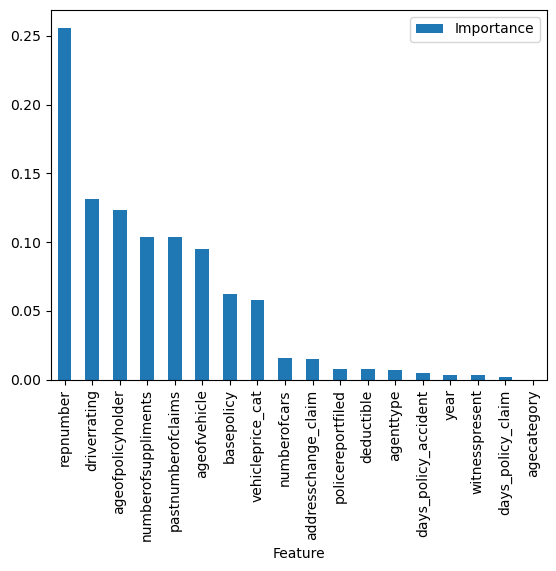

In [44]:
importances_dt.plot.bar();

In [45]:
rf_model = RandomForestClassifier()
rf_model.fit(X_train, y_train);

In [46]:
from sklearn.metrics import confusion_matrix

# Örnek olarak y_pred_rf ve y_test değişkenlerini kullanarak confusion matrix hesaplaması
y_pred_rf = rf_model.predict(X_test)
cm = confusion_matrix(y_test, y_pred_rf)

print("Confusion Matrix:")
print(cm)


Confusion Matrix:
[[18 20 24 18 23 18 27 18 27 25 28 20]
 [12 17 21 17 23 21 16 24 14 19 18 13]
 [15 15 17 25 24 21 21 13 31 25 30 17]
 [19 11 22 25 29 20 15 25 14 22 17 16]
 [18 17 28 19 23 25 34 33 29 17 22 25]
 [17 22 24 23 21 17 28 24 18 14 20 17]
 [22 21 21 26 23 19 14 23 26 21 18 19]
 [32 20 25 22 26 20 21 29 37 24 19 20]
 [26 11 25 19 33 22 31 26 34 23 32 20]
 [19 10 22 12 27 19 20 26 26 17 22 20]
 [21 21 24 22 23 28 12 21 18 21 30 12]
 [23 23 19 17 24 17 24 21 18 12 21 17]]


In [47]:
importances_rf = pd.DataFrame({'Feature':X_train.columns,'Importance':np.round(rf_model.feature_importances_,3)})
importances_rf = importances_rf.sort_values('Importance', ascending=False).set_index('Feature')
importances_rf

,Importance
Feature,
repnumber,0.268
driverrating,0.116
ageofpolicyholder,0.112
pastnumberofclaims,0.098
ageofvehicle,0.097
numberofsuppliments,0.092
basepolicy,0.063
vehicleprice_cat,0.045
year,0.043


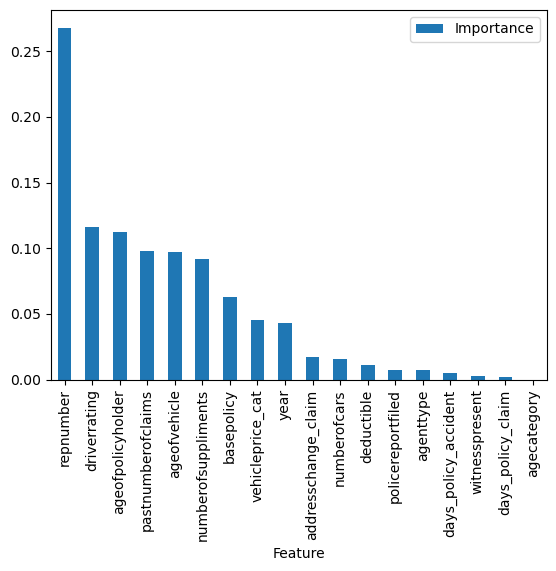

In [48]:
importances_rf.plot.bar();

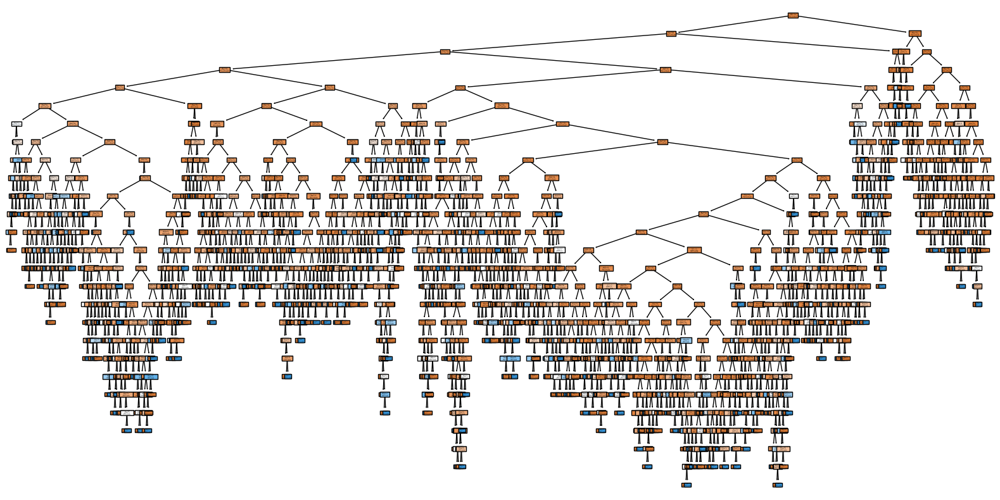

In [49]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
import matplotlib.pyplot as plt

# Hedef sütunu hariç, bağımsız değişkenleri seçelim
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Karar ağacı modelini oluşturalım
dt_model = DecisionTreeClassifier()
dt_model.fit(X, y)

# Karar ağacını görselleştirelim
plt.figure(figsize=(20,10))
plot_tree(dt_model, filled=True, feature_names=X.columns.tolist(), class_names=['No Fraud', 'Fraud'])
plt.show()

In [50]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
import matplotlib.pyplot as plt

# Hedef sütunu hariç, bağımsız değişkenleri seçelim
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Karar ağacı modelini oluşturalım
dt_model = DecisionTreeClassifier()
dt_model.fit(X, y)

# Karar ağacını görselleştirelim, DPI ve figür boyutunu ayarlayarak
plt.figure(figsize=(30,20), dpi=1000)
plot_tree(dt_model, filled=True, feature_names=X.columns.tolist(), class_names=['No Fraud', 'Fraud'])
plt.show()

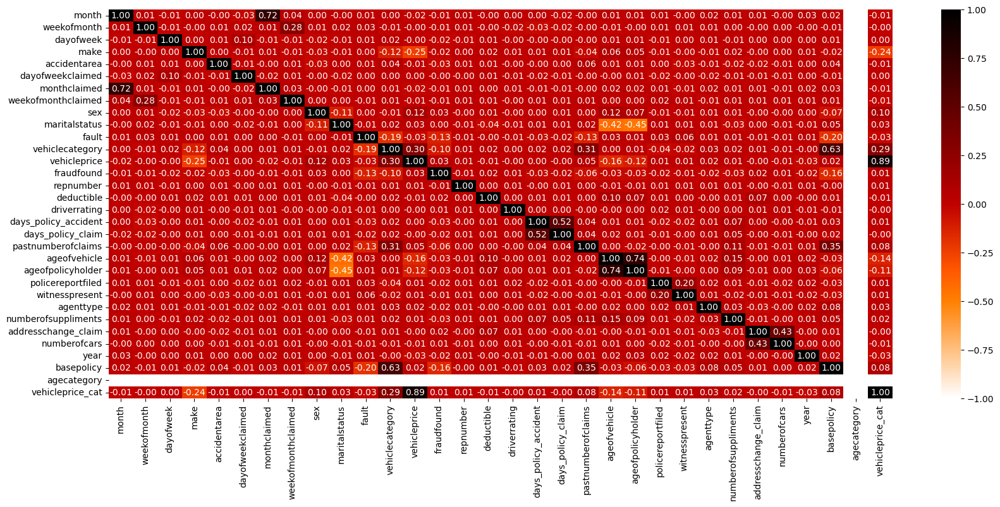

In [51]:
plt.figure(figsize=[20,8])
sns.heatmap(df.corr(), cmap="gist_heat_r", annot=True, vmin=-1, vmax=1, fmt='.2f');

In [52]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Karar ağacı modelini oluşturalım ve eğitelim
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = dt_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("Modelin doğruluk skoru:", accuracy)

Modelin doğruluk skoru: 0.8884565499351491


In [53]:
from sklearn.metrics import classification_report, roc_auc_score
from sklearn.model_selection import cross_val_score

# Hassasiyet, duyarlılık ve F1 skoru
print(classification_report(y_test, y_pred))

# ROC eğrisi altında kalan alan (AUC) hesaplama
auc = roc_auc_score(y_test, y_pred)
print("ROC AUC Score:", auc)

# Çapraz doğrulama ile modeli değerlendirme
cv_scores = cross_val_score(dt_model, X, y, cv=5)
print("Çapraz Doğrulama Skorları:", cv_scores)

              precision    recall  f1-score   support

           0       0.95      0.93      0.94      2903
           1       0.17      0.24      0.20       181

    accuracy                           0.89      3084
   macro avg       0.56      0.58      0.57      3084
weighted avg       0.91      0.89      0.90      3084

ROC AUC Score: 0.5833039930116112
Çapraz Doğrulama Skorları: [0.88586252 0.88586252 0.88521401 0.89202335 0.90110246]


In [54]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost modelini tanımlayalım ve parametreleri ayarlayalım
xgb_model = xgb.XGBClassifier(objective='binary:logistic', random_state=42)

# Modeli eğitelim
xgb_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = xgb_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("Modelin doğruluk skoru:", accuracy)


Modelin doğruluk skoru: 0.938715953307393


In [55]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Random Forest modelini tanımlayalım ve eğitelim
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = rf_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("Modelin doğruluk skoru:", accuracy)


Modelin doğruluk skoru: 0.9416342412451362


In [56]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# K-Nearest Neighbors modelini tanımlayalım ve eğitelim
knn_model = KNeighborsClassifier()
knn_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = knn_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("K-Nearest Neighbors Modelinin doğruluk skoru:", accuracy)


K-Nearest Neighbors Modelinin doğruluk skoru: 0.9396887159533074


In [57]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Gradient Boosting modelini tanımlayalım ve eğitelim
gb_model = GradientBoostingClassifier()
gb_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = gb_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("Gradient Boosting Modelinin doğruluk skoru:", accuracy)


Gradient Boosting Modelinin doğruluk skoru: 0.941958495460441


In [58]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Logistic Regression modelini tanımlayalım ve eğitelim
lr_model = LogisticRegression()
lr_model.fit(X_train, y_train)

# Test verileriyle modeli değerlendirelim
y_pred = lr_model.predict(X_test)

# Modelin doğruluk skorunu hesaplayalım
accuracy = accuracy_score(y_test, y_pred)
print("Logistic Regression Modelinin doğruluk skoru:", accuracy)


Logistic Regression Modelinin doğruluk skoru: 0.9413099870298314


In [59]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Decision Tree modelini tanımlayalım ve eğitelim
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)

# Random Forest modelini tanımlayalım ve eğitelim
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)

# XGBoost modelini tanımlayalım ve eğitelim
xgb_model = xgb.XGBClassifier(objective='binary:logistic', random_state=42)
xgb_model.fit(X_train, y_train)

# Model sonuçlarını değerlendirelim
models = {
    "Decision Tree": dt_model,
    "Random Forest": rf_model,
    "XGBoost": xgb_model
}

results = {}

for name, model in models.items():
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    results[name] = accuracy

# Sonuçları ekrana yazdırın
print("Model Karşılaştırması:")
print("----------------------")
for name, accuracy in results.items():
    print(f"{name}: {accuracy:.4f} doğruluk skoru")


Model Karşılaştırması:
----------------------
Decision Tree: 0.8914 doğruluk skoru
Random Forest: 0.9416 doğruluk skoru
XGBoost: 0.9387 doğruluk skoru


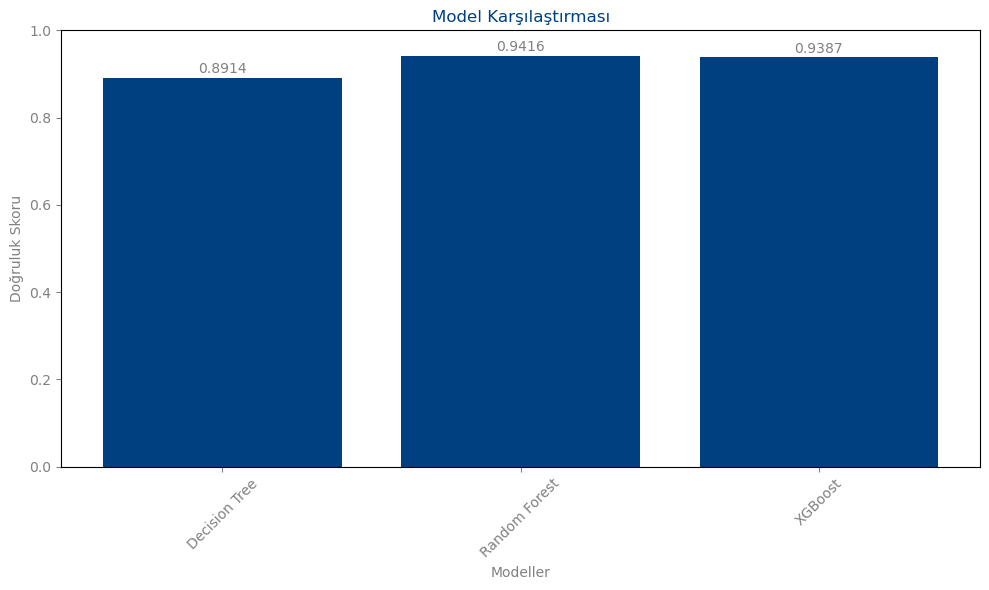

In [60]:
import matplotlib.pyplot as plt

# Model isimleri ve doğruluk skorları
model_names = list(results.keys())
accuracies = list(results.values())

# Renk paleti
main_color = '#004080'      # Ana Renk: Koyu Mavi
accent_color = '#FFA500'    # Birincil Vurgu: Turuncu
secondary_color = '#808080' # İkincil Vurgu: Gri
optional_color = '#6FA8DC'  # Opsiyonel: Açık Mavi

# Çubuk grafik oluşturma
plt.figure(figsize=(10, 6))
bars = plt.bar(model_names, accuracies, color=main_color)

# Doğruluk skorlarını çubukların üzerine yazma
for bar, accuracy in zip(bars, accuracies):
    plt.text(bar.get_x() + bar.get_width() / 2, 
             bar.get_height() + 0.01,
             f'{accuracy:.4f}',
             ha='center',
             color=secondary_color)

# Grafik başlığı ve eksen etiketleri
plt.title('Model Karşılaştırması', color=main_color)
plt.xlabel('Modeller', color=secondary_color)
plt.ylabel('Doğruluk Skoru', color=secondary_color)

# Eksen renkleri
plt.tick_params(axis='x', colors=secondary_color)
plt.tick_params(axis='y', colors=secondary_color)

# Grafik gösterme
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [61]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Bağımsız değişkenler (X) ve bağımlı değişken (y) olarak ayıralım
X = df.drop('fraudfound', axis=1)
y = df['fraudfound']

# Eğitim ve test veri kümelerini ayıralım
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Decision Tree modelini tanımlayalım ve eğitelim
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)

# Random Forest modelini tanımlayalım ve eğitelim
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)

# XGBoost modelini tanımlayalım ve eğitelim
xgb_model = xgb.XGBClassifier(objective='binary:logistic', random_state=42)
xgb_model.fit(X_train, y_train)

# Logistic Regression modelini tanımlayalım ve eğitelim
lr_model = LogisticRegression()
lr_model.fit(X_train, y_train)

# Gradient Boosting modelini tanımlayalım ve eğitelim
gb_model = GradientBoostingClassifier()
gb_model.fit(X_train, y_train)

# K-Nearest Neighbors modelini tanımlayalım ve eğitelim
knn_model = KNeighborsClassifier()
knn_model.fit(X_train, y_train)

# Model sonuçlarını değerlendirelim
models = {
    "Decision Tree": dt_model,
    "Random Forest": rf_model,
    "XGBoost": xgb_model,
    "Logistic Regression": lr_model,
    "Gradient Boosting": gb_model,
    "K-Nearest Neighbors": knn_model
}

results = {}

for name, model in models.items():
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    results[name] = accuracy

# Sonuçları ekrana yazdırın
print("Model Karşılaştırması:")
print("----------------------")
for name, accuracy in results.items():
    print(f"{name}: {accuracy:.4f} doğruluk skoru")


Model Karşılaştırması:
----------------------
Decision Tree: 0.8914 doğruluk skoru
Random Forest: 0.9416 doğruluk skoru
XGBoost: 0.9387 doğruluk skoru
Logistic Regression: 0.9413 doğruluk skoru
Gradient Boosting: 0.9420 doğruluk skoru
K-Nearest Neighbors: 0.9397 doğruluk skoru


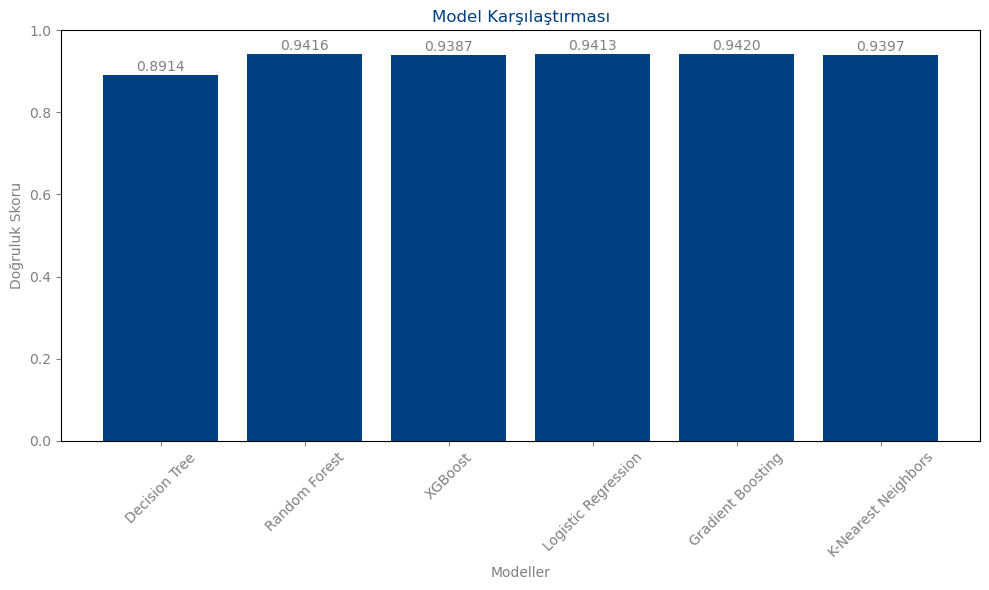

In [62]:
import matplotlib.pyplot as plt

# Model isimleri ve doğruluk skorları
model_names = list(results.keys())
accuracies = list(results.values())

# Renk paleti
main_color = '#004080'      # Ana Renk: Koyu Mavi
accent_color = '#FFA500'    # Birincil Vurgu: Turuncu
secondary_color = '#808080' # İkincil Vurgu: Gri
optional_color = '#6FA8DC'  # Opsiyonel: Açık Mavi

# Çubuk grafik oluşturma
plt.figure(figsize=(10, 6))
bars = plt.bar(model_names, accuracies, color=main_color)

# Doğruluk skorlarını çubukların üzerine yazma
for bar, accuracy in zip(bars, accuracies):
    plt.text(bar.get_x() + bar.get_width() / 2, 
             bar.get_height() + 0.01,
             f'{accuracy:.4f}',
             ha='center',
             color=secondary_color)

# Grafik başlığı ve eksen etiketleri
plt.title('Model Karşılaştırması', color=main_color)
plt.xlabel('Modeller', color=secondary_color)
plt.ylabel('Doğruluk Skoru', color=secondary_color)

# Eksen renkleri
plt.tick_params(axis='x', colors=secondary_color)
plt.tick_params(axis='y', colors=secondary_color)

# Grafik gösterme
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [63]:
from joblib import dump, load

# Modeli pickle kullanarak kaydetme
dump(gb_model, 'aaa.pkl')

['aaa.pkl']

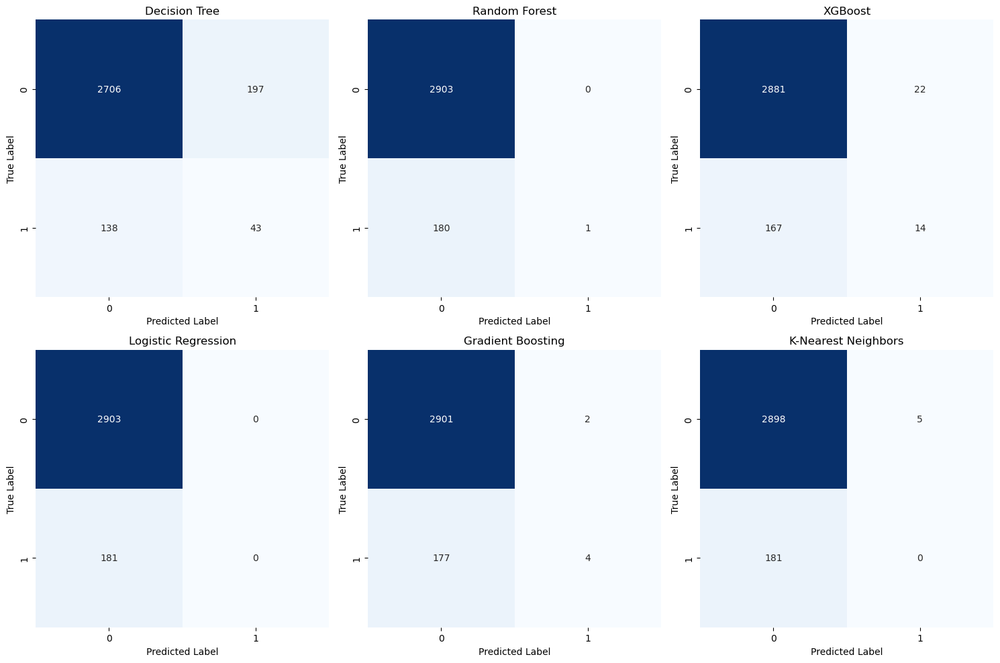

In [69]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Her bir model için confusion matrix hesaplayın
models = [dt_model, rf_model, xgb_model, lr_model, gb_model, knn_model]
model_names = ['Decision Tree', 'Random Forest', 'XGBoost', 'Logistic Regression', 'Gradient Boosting', 'K-Nearest Neighbors']

plt.figure(figsize=(15, 10))

for i, model in enumerate(models, 1):
    plt.subplot(2, 3, i)
    y_pred = model.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title(model_names[i-1])
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

plt.tight_layout()
plt.show()


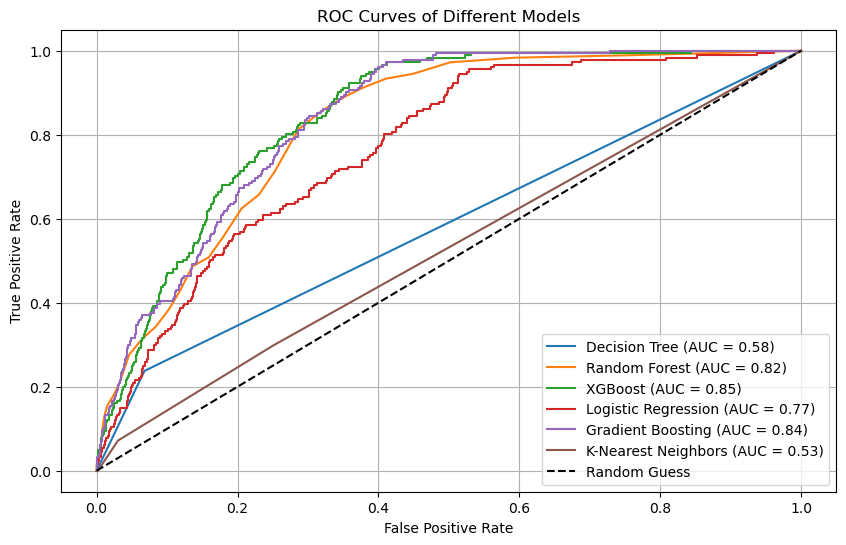

In [70]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

# Her bir model için ROC eğrilerini çizin
for model, name in zip(models, model_names):
    y_pred_proba = model.predict_proba(X_test)[:,1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc = roc_auc_score(y_test, y_pred_proba)
    plt.plot(fpr, tpr, label=f'{name} (AUC = {auc:.2f})')

# ROC eğrisi için rasgele tahmin yapma doğruluğu (50%)
plt.plot([0, 1], [0, 1], linestyle='--', color='black', label='Random Guess')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves of Different Models')
plt.legend()
plt.grid(True)
plt.show()


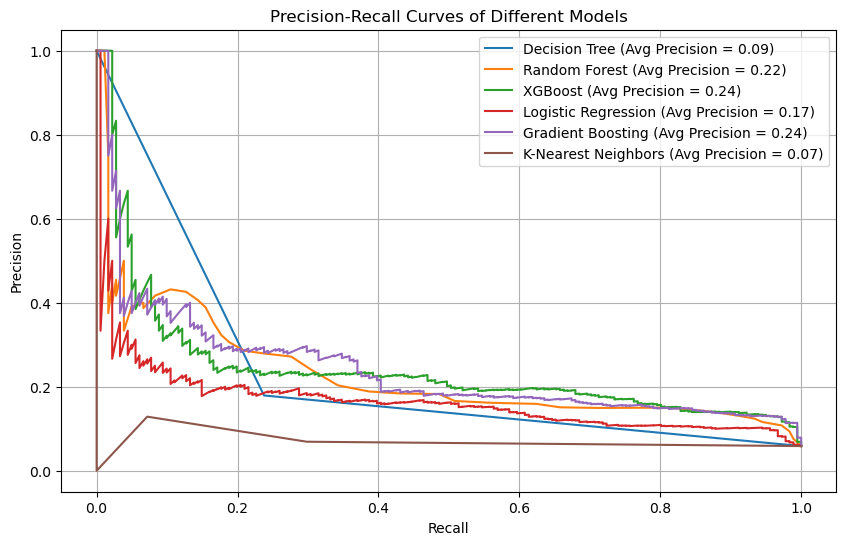

In [71]:
from sklearn.metrics import precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

# Her bir model için Precision-Recall eğrilerini çizin
for model, name in zip(models, model_names):
    y_pred_proba = model.predict_proba(X_test)[:,1]
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    avg_precision = average_precision_score(y_test, y_pred_proba)
    plt.plot(recall, precision, label=f'{name} (Avg Precision = {avg_precision:.2f})')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curves of Different Models')
plt.legend()
plt.grid(True)
plt.show()


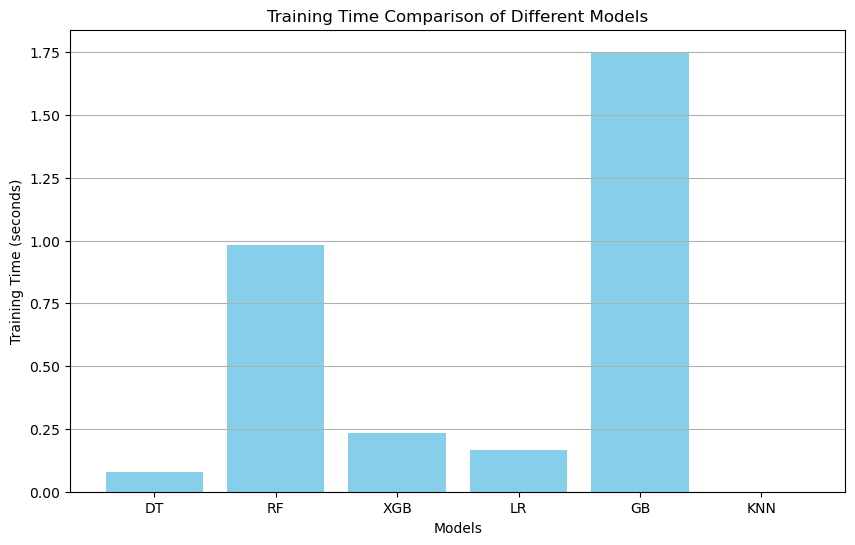

In [72]:
import time
import numpy as np
import matplotlib.pyplot as plt

# Her bir modelin eğitim süresini ölçün
train_times = []
for model in models:
    start_time = time.time()
    model.fit(X_train, y_train)
    end_time = time.time()
    train_time = end_time - start_time
    train_times.append(train_time)

# Model isimlerini düzenleyin
short_model_names = ['DT', 'RF', 'XGB', 'LR', 'GB', 'KNN']

# Eğitim sürelerini çiz
plt.figure(figsize=(10, 6))
plt.bar(short_model_names, train_times, color='skyblue')
plt.xlabel('Models')
plt.ylabel('Training Time (seconds)')
plt.title('Training Time Comparison of Different Models')
plt.grid(axis='y')
plt.show()


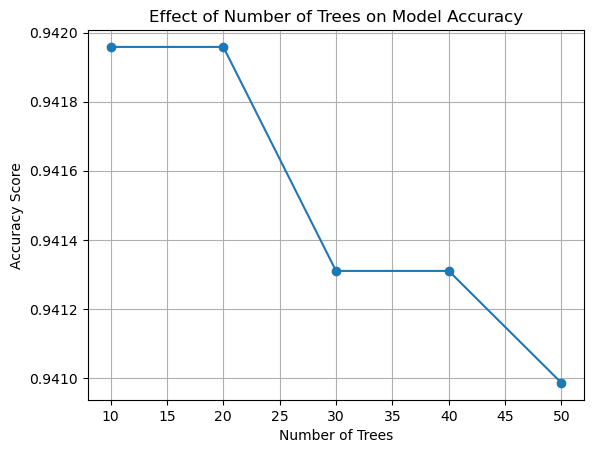

In [73]:
import numpy as np
import matplotlib.pyplot as plt

# Değiştirilecek hiperparametre değerlerini belirleyin
hyperparameter_values = [10, 20, 30, 40, 50]
accuracy_scores = []

# Her bir hiperparametre değeri için modelin performansını ölçün
for value in hyperparameter_values:
    # Modeli oluşturun ve hiperparametreyi ayarlayın
    model = RandomForestClassifier(n_estimators=value, random_state=42)
    model.fit(X_train, y_train)
    
    # Modelin performansını ölçün
    accuracy = model.score(X_test, y_test)
    accuracy_scores.append(accuracy)

# Hiperparametre değerlerinin model performansına etkisini gösteren bir grafik çizin
plt.plot(hyperparameter_values, accuracy_scores, marker='o')
plt.xlabel('Number of Trees')
plt.ylabel('Accuracy Score')
plt.title('Effect of Number of Trees on Model Accuracy')
plt.grid(True)
plt.show()


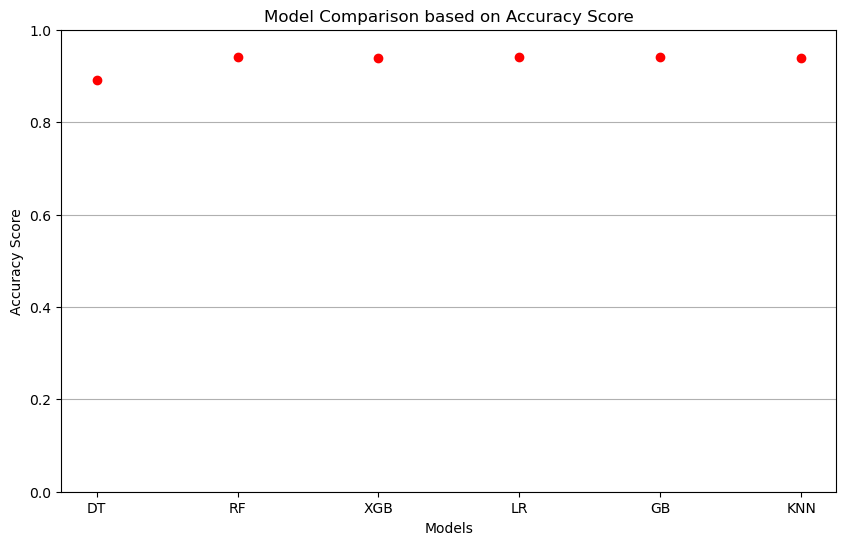

In [74]:
import matplotlib.pyplot as plt

# Model isimlerini düzenleyin
short_model_names = ['DT', 'RF', 'XGB', 'LR', 'GB', 'KNN']

# Model performans metriklerini toplayın
accuracy_scores = [model.score(X_test, y_test) for model in models]

# Nokta grafiği ile model performansını görselleştirin
plt.figure(figsize=(10, 6))
plt.scatter(short_model_names, accuracy_scores, color='red')
plt.xlabel('Models')
plt.ylabel('Accuracy Score')
plt.title('Model Comparison based on Accuracy Score')
plt.grid(axis='y')
plt.ylim(0, 1)  # Y eksenini 0-1 arasında sınırlayın (doğruluk 0 ile 1 arasındadır)
plt.show()


Best Model: Gradient Boosting
Accuracy Score: 0.94


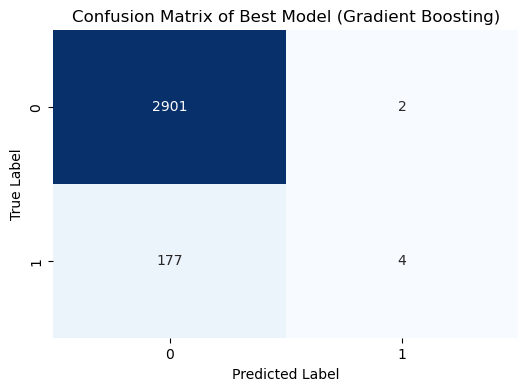

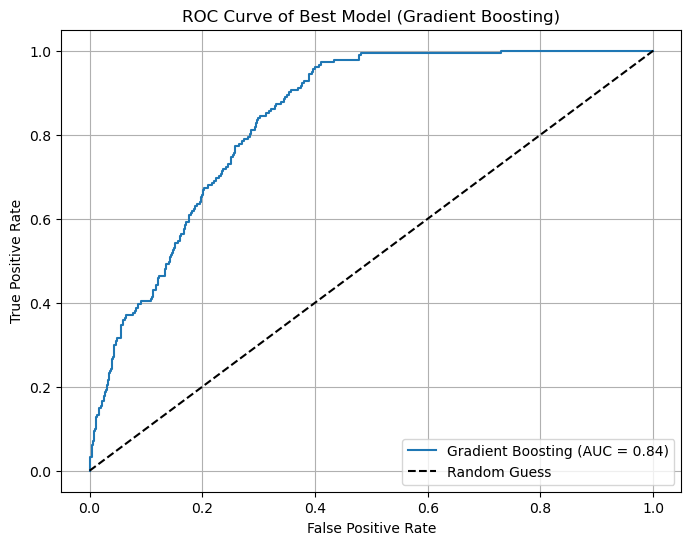

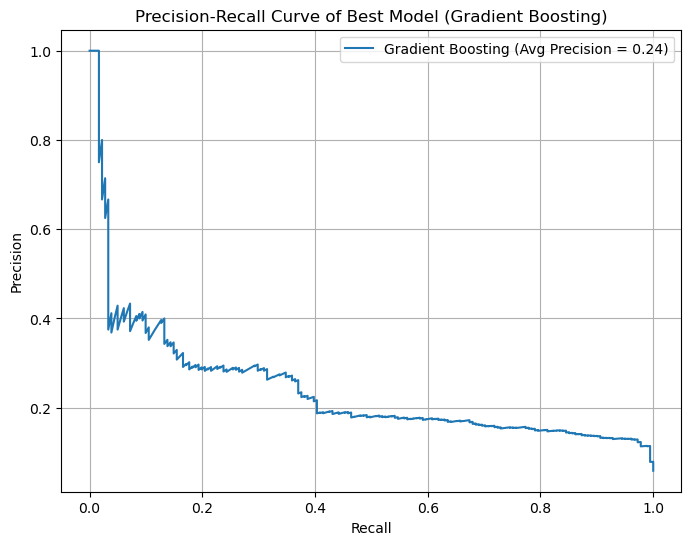

In [75]:
# Her bir model için doğruluk skorlarını hesaplayın
accuracy_scores = [model.score(X_test, y_test) for model in models]

# En iyi modeli belirleyin
best_model_index = np.argmax(accuracy_scores)
best_model = models[best_model_index]
best_model_name = model_names[best_model_index]
best_accuracy = accuracy_scores[best_model_index]

# En iyi modelin bilgilerini yazdırın
print(f"Best Model: {best_model_name}")
print(f"Accuracy Score: {best_accuracy:.2f}")

# En iyi modelin confusion matrix'ini çizin
y_pred = best_model.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title(f"Confusion Matrix of Best Model ({best_model_name})")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# En iyi modelin ROC eğrisini çizin
y_pred_proba = best_model.predict_proba(X_test)[:,1]
fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'{best_model_name} (AUC = {auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='black', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve of Best Model ({best_model_name})')
plt.legend()
plt.grid(True)
plt.show()

# En iyi modelin Precision-Recall eğrisini çizin
precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
avg_precision = average_precision_score(y_test, y_pred_proba)
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label=f'{best_model_name} (Avg Precision = {avg_precision:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve of Best Model ({best_model_name})')
plt.legend()
plt.grid(True)
plt.show()


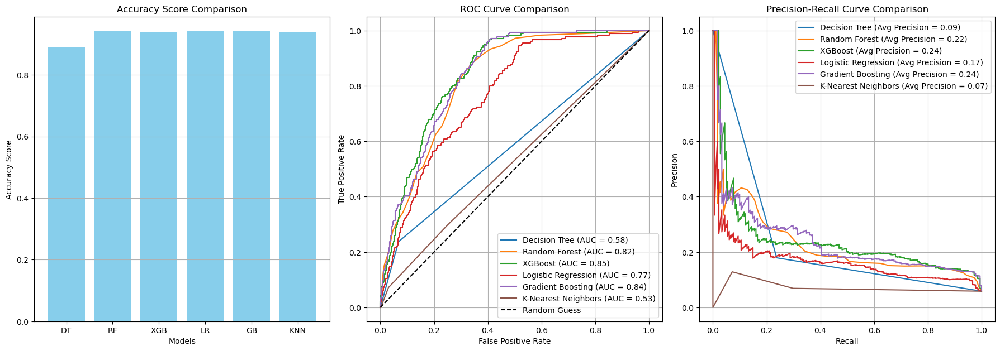

In [76]:
from sklearn.metrics import precision_recall_curve, average_precision_score, roc_curve, roc_auc_score

plt.figure(figsize=(18, 12))

# Model isimlerini düzenleyin
short_model_names = ['DT', 'RF', 'XGB', 'LR', 'GB', 'KNN']

# Doğruluk alt grafiği
plt.subplot(2, 3, 1)
plt.bar(short_model_names, accuracy_scores, color='skyblue')
plt.xlabel('Models')
plt.ylabel('Accuracy Score')
plt.title('Accuracy Score Comparison')
plt.grid(axis='y')

# ROC eğrisi alt grafiği
plt.subplot(2, 3, 2)
for model, name in zip(models, model_names):
    y_pred_proba = model.predict_proba(X_test)[:,1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc = roc_auc_score(y_test, y_pred_proba)
    plt.plot(fpr, tpr, label=f'{name} (AUC = {auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='black', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve Comparison')
plt.legend()
plt.grid(True)

# Precision-Recall eğrisi alt grafiği
plt.subplot(2, 3, 3)
for model, name in zip(models, model_names):
    y_pred_proba = model.predict_proba(X_test)[:,1]
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    avg_precision = average_precision_score(y_test, y_pred_proba)
    plt.plot(recall, precision, label=f'{name} (Avg Precision = {avg_precision:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve Comparison')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


In [77]:
from sklearn.model_selection import cross_val_score

# Son modelinizin performansını çapraz doğrulama ile değerlendirin
cv_scores = cross_val_score(best_model, X, y, cv=5)  # 5 katlı çapraz doğrulama
print("Cross-Validation Scores:", cv_scores)
print("Mean CV Score:", np.mean(cv_scores))


Cross-Validation Scores: [0.94066148 0.94163424 0.94163424 0.94098573 0.94163424]
Mean CV Score: 0.9413099870298314


In [83]:
import lime
import lime.lime_tabular

# LIME açıklama nesnelerini tanımlayın

gb_explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns, class_names=['not_fraud', 'fraud'])


# Model tahminlerini açıklayın ve değerlendirin
gb_exp = gb_explainer.explain_instance(X_test.iloc[idx].values, gb_model.predict_proba, num_features=5)


# Açıklamaları görselleştirin
gb_exp.show_in_notebook()



In [85]:
import lime
import lime.lime_tabular

# LIME açıklama nesnesini tanımlayın ve özellik adlarını ve benzersiz değerlerini belirtin
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, 
                                                   feature_names=['month', 'weekofmonth', 'dayofweek', 'make', 'accidentarea', 
                                                                  'dayofweekclaimed', 'monthclaimed', 'weekofmonthclaimed', 
                                                                  'sex', 'maritalstatus', 'fault', 'vehiclecategory', 
                                                                  'vehicleprice', 'fraudfound', 'repnumber', 'deductible', 
                                                                  'driverrating', 'days_policy_accident', 'days_policy_claim', 
                                                                  'pastnumberofclaims', 'ageofvehicle', 'ageofpolicyholder', 
                                                                  'policereportfiled', 'witnesspresent', 'agenttype', 
                                                                  'numberofsuppliments', 'addresschange_claim', 'numberofcars', 
                                                                  'year', 'basepolicy', 'agecategory', 'vehicleprice_cat'], 
                                                   class_names=['not_fraud', 'fraud'])

# Tahmin edilecek örnek indeksi seçin
idx = 0  

# Model tahminlerini açıklayın ve değerlendirin
gb_exp = explainer.explain_instance(X_test.iloc[idx].values, 
                                    gb_model.predict_proba, 
                                    num_features=5)

# Açıklamaları görselleştirin
gb_exp.show_in_notebook()


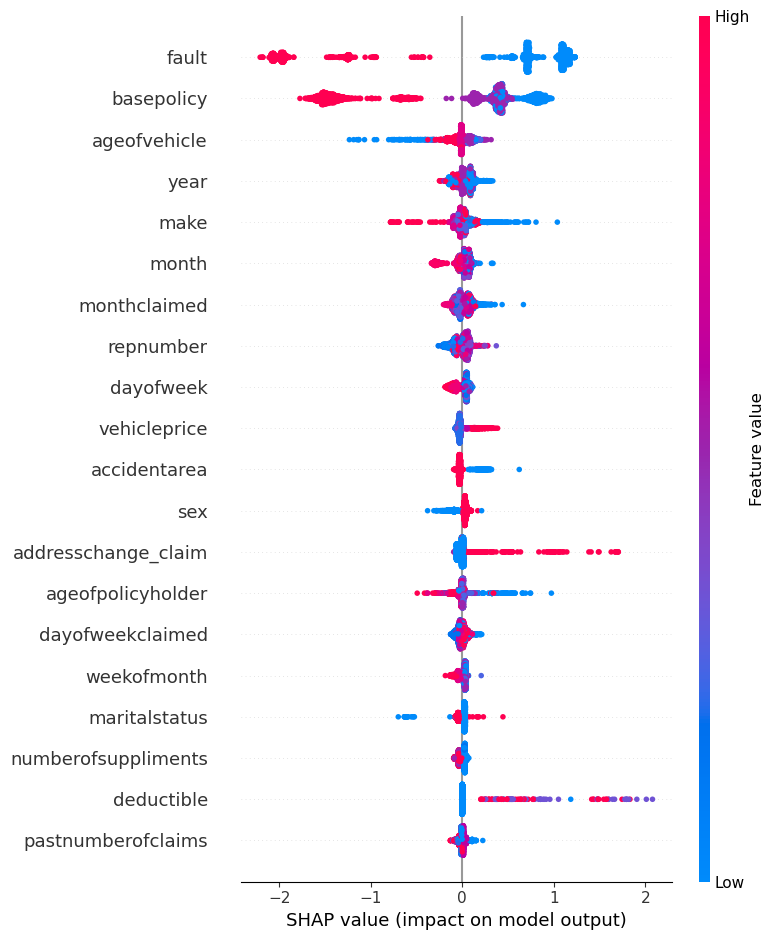

In [86]:
import shap

# SHAP açıklamalarını oluşturmak için explainer nesnesini tanımlayın
explainer = shap.Explainer(gb_model, X_train)

# Örnek veri üzerinde SHAP değerlerini hesaplayın
shap_values = explainer.shap_values(X_test)

# SHAP değerlerini görselleştirin
shap.summary_plot(shap_values, X_test)
